In [1]:
import xarray as xr
import dask
import numpy as np
import hvplot.xarray

import numpy as np
import matplotlib.pyplot as plt


%load_ext autoreload
%autoreload 2
from anndata import AnnData
import squidpy as sq
import scanpy as sc
from cellpose import models, io
import matplotlib.pyplot as plt
from modest_image import ModestImage, imshow
from skimage.restoration import inpaint
#%matplotlib widget
import cv2
import torch
from skimage import io, morphology
import skimage.feature as features
from scipy import ndimage
import time
from tqdm.notebook import tqdm
import scipy
import seaborn as sns

import skimage
from skimage.measure import regionprops, regionprops_table, approximate_polygon
from shapely.geometry import Polygon
from shapely.geometry.polygon import LinearRing
import geopandas
import scanpy as sc
import rasterio
from rasterio import features
import shapely
from shapely.geometry import Point, Polygon
import matplotlib
from matplotlib.colors import Normalize

from napari_sparrow import functions as fc
from dask.distributed import Client

napari.manifest -> 'napari-spongepy' could not be imported: Cannot find module 'napari_spongepy' declared in entrypoint: 'napari_spongepy:napari.yaml'
/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/geopandas/_compat.py:123: UserWarning: The Shapely GEOS version (3.11.1-CAPI-1.17.1) is incompatible with the GEOS version PyGEOS was compiled with (3.10.3-CAPI-1.16.1). Conversions between both will be slow.
  warnings.warn(
/tmp/ipykernel_126225/598552885.py:34: UserWarning: Shapely 2.0 is installed, but because PyGEOS is also installed, GeoPandas will still use PyGEOS by default for now. To force to use and test Shapely 2.0, you have to set the environment variable USE_PYGEOS=0. You can do this before starting the Python process, or in your code before importing geopandas:

import os
os.environ['USE_PYGEOS'] = '0'
import geopandas

In a future release, GeoPandas will switch to using Shapely by default. If you are using PyGEOS directly (calling PyGEOS funct

These are the location on the cluster, however, with this link:
https://dl01.irc.ugent.be/spatial/vizgen/triesLotte/

You can find back all code and read it in. 

vizgen_liver_DAPI_0.zarr is the complete dapi file

vizgen_liver_polyT_0.zarr is the complete polyT file

vizgen_liver_polyT_45_000.zarr is a subset of the polyT staining.

markerGenesVizgen.csv gives the markergenes file. 

The mtranscripts locations are to e read i from https://dl01.irc.ugent.be/spatial/liver/vz-liver-showcase/Liver1Slice1/detected_transcripts.csv

In [3]:
client = Client(n_workers=1, threads_per_worker=1, memory_limit='200GB',local_directory='/srv/scratch',dashboard_address=42738)
client

/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/distributed/node.py:183: UserWarning: Port 42738 is already in use.
Perhaps you already have a cluster running?
Hosting the HTTP server on port 36266 instead
  warnings.warn(


Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:36266/status,
Dashboard: http://127.0.0.1:36266/status,Workers: 1
Total threads: 1,Total memory: 186.26 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:43524,Workers: 1
Dashboard: http://127.0.0.1:36266/status,Total threads: 1
Started: Just now,Total memory: 186.26 GiB
Comm: tcp://127.0.0.1:43505,Total threads: 1
Dashboard: http://127.0.0.1:41945/status,Memory: 186.26 GiB
Nanny: tcp://127.0.0.1:34812,


In [4]:
ic = fc.read_in_zarr('https://dl01.irc.ugent.be/spatial/vizgen/triesLotte/vizgen_Liver_polyT_45_000.zarr/')
ic

ImageContainer[shape=(45000, 45000), layers=['image']]

615.5394792556763


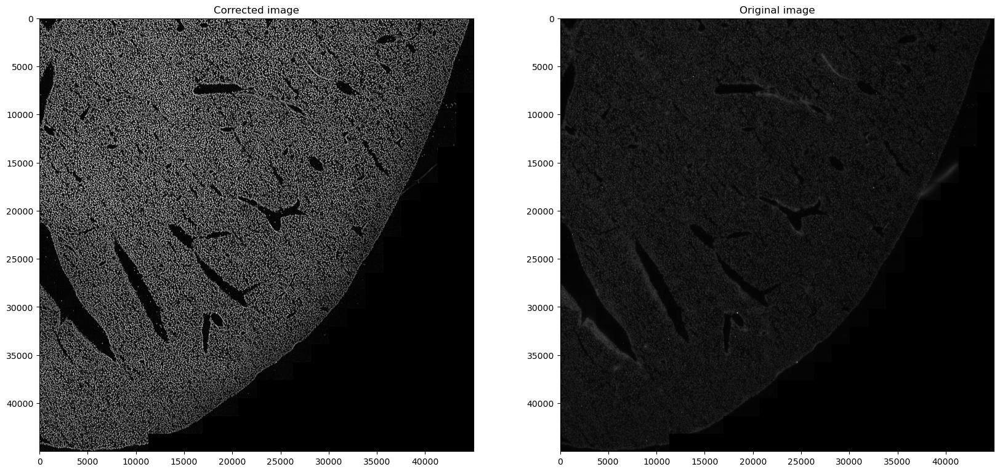

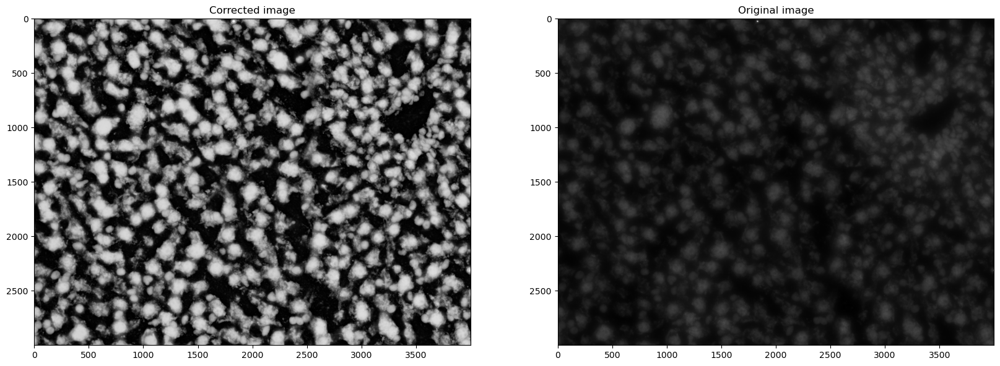

In [6]:
crd = [3000, 6000, 5000, 9000] # a small subset of interest for visualization purposes.
t0 = time.time()
ic_preproces = fc.preprocessImage(img=ic, size_tophat=135, contrast_clip=18.5)
print(time.time() - t0)
fc.preprocessImagePlot(ic_preproces.data.image.squeeze().to_numpy(), ic.data.image.squeeze().to_numpy(), small_size_vis=crd)

In [8]:
#Run this code if you want to perfrom everything on a subset to perform tests. 
#ic_test=create_subset_image(ic_preproces,crd=[0,3000,0,3000])

In [51]:
masks,mask_i,polygons,img=fc.segmentation(img=ic_preproces,min_size=80,cellprob_threshold=-4, flow_threshold=0.85, diameter=100, model_type="cyto",channels=[1,0],device='cuda:4')

In [ ]:
masks,mask_i,polygons,img=fc.segmentation(img=ic_preproces,min_size=80,cellprob_threshold=-4, flow_threshold=0.85, diameter=100, model_type="nuclei",channels=[0,0],device='cuda:4')

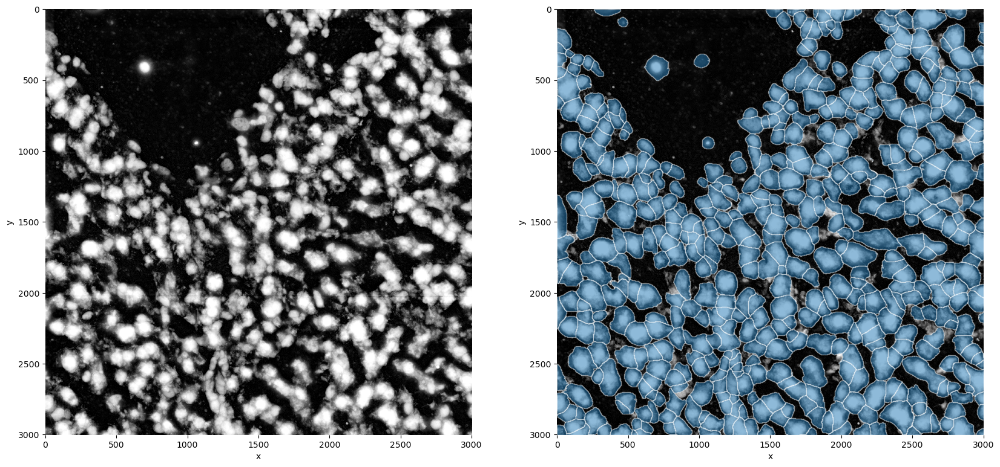

In [41]:
fc.segmentationPlot(img,polygons=polygons)

In [22]:
#np.save('/srv/scratch/lottep/vizgen/maskpolyTsubset.npy',masks)

In [15]:
import dask.dataframe as dd
path_genes='/srv/scratch/vizgen/vz-liver-showcase/Liver1Slice1/detected_transcripts.csv'
ddf=fc.read_in_Vizgen(path_genes,offset=[45000,45000],bbox=[-41.61239999999996,-107.97948000000231],pixelSize=0.108,filterGenes=["Blank-"])

In [32]:
def allocation(ddf,ic: sq.im.ImageContainer, masks: np.ndarray=None, library_id: str = "spatial_transcriptomics",radius=0,polygons=None, verbose=False):
    """This function performs """
    
    # Create the polygon shapes for the mask
    if polygons is None:
        polygons = fc.mask_to_polygons_layer(masks)
        polygons["cells"] = polygons.index
        polygons = polygons.dissolve(by="cells")
    polygons.index = list(map(str, polygons.index))
    
    #calculate new mask based on radius    
    if radius!=0:
        boundary=Polygon([(0,0),(ic.shape[1]+200,0),(ic.shape[1]+200,ic.shape[0]+200),(0,ic.shape[0]+200)])
        polygons['geometry']=polygons.simplify(2)
        vd = voronoiDiagram4plg(polygons, boundary)
        voronoi=geopandas.sjoin(vd,polygons,predicate='contains',how='left')
        voronoi.index=voronoi.index_right
        voronoi=delete_overlap(voronoi,polygons)

        buffered=polygons.buffer(distance=radius)
        intersected=voronoi.intersection(buffered)
        polygons.geometry=intersected
        
        masks=rasterio.features.rasterize( #it should be possible to give every shape  number. You need to give the value with it as input. 
            zip(buffered.geometry,buffered.index.values.astype(float)), 
            out_shape=[ic.shape[0],ic.shape[1]],dtype='uint32')    
        
    # adapt transcripts file     
    ddf = ddf[
    (ic.data.attrs["coords"].y0 < ddf['y'])
    & (ddf['y'] < masks.shape[0] + ic.data.attrs["coords"].y0)
    & (ic.data.attrs["coords"].x0 < ddf['x'])
    & (ddf['x'] < masks.shape[1] + ic.data.attrs["coords"].x0)
    ]
    if verbose:
        print('Started df calculation')

    df=ddf.compute()
    if verbose:
        print('df calculated')
    df["cells"] = masks[
        df['y'].values.astype(int) - ic.data.attrs["coords"].y0,
        df['x'].values.astype(int) - ic.data.attrs["coords"].x0,
    ]
    if masks is None:
        masks=ic.data.segment_cellpose.squeeze().to_numpy()
    # Calculate the mean of the transcripts for every cell
    coordinates = df.groupby(["cells"]).mean().loc[:, ['x', 'y']]
    cell_counts = df.groupby(["cells", "gene"]).size().unstack(fill_value=0)
    print('finished groupbe')
        # Create the anndata object
    adata = AnnData(cell_counts[cell_counts.index != 0])
    coordinates.index = coordinates.index.map(str)
    adata.obsm["spatial"] = coordinates[coordinates.index != "0"].values
    if verbose:
        print('created anndata object')
    # Add the polygons to the anndata object
    polygons["linewidth"] = polygons.geometry.map(fc.linewidth)

    polygons_f = polygons[
        np.isin(polygons.index.values, adata.obs.index.values)
    ]
    #polygons_f.index = list(map(str, polygons_f.index))
    adata.obsm["polygons"] = polygons_f
    adata.obs["cell_ID"] = [int(x) for x in adata.obsm["polygons"].index]

    # Add the figure to the anndata object
    adata.uns["spatial"] = {library_id: {}}
    adata.uns["spatial"][library_id]["images"] = {}
    adata.uns["spatial"][library_id]["images"] = {
        "hires": ic.data.image.squeeze().to_numpy()
        #"segmentation":ic.data.segment_cellpose.squeeze().to_numpy()
    }
    adata.uns["spatial"][library_id]["scalefactors"] = {
        "tissue_hires_scalef": 1,
        "spot_diameter_fullres": 75,
    }
    #adata.uns["spatial"][library_id]["segmentation"] = masks.astype(np.uint16)

    return adata,df

In [44]:
adata,df=fc.allocation(ddf,img,masks=masks,polygons=polygons,verbose=True)

Started df calculation
df calculated
finished groupbe
created anndata object


/srv/scratch/lottep/tryout_spongepy/napari-spongepy/src/napari_sparrow/functions.py:553: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = AnnData(cell_counts[cell_counts.index != 0])
/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


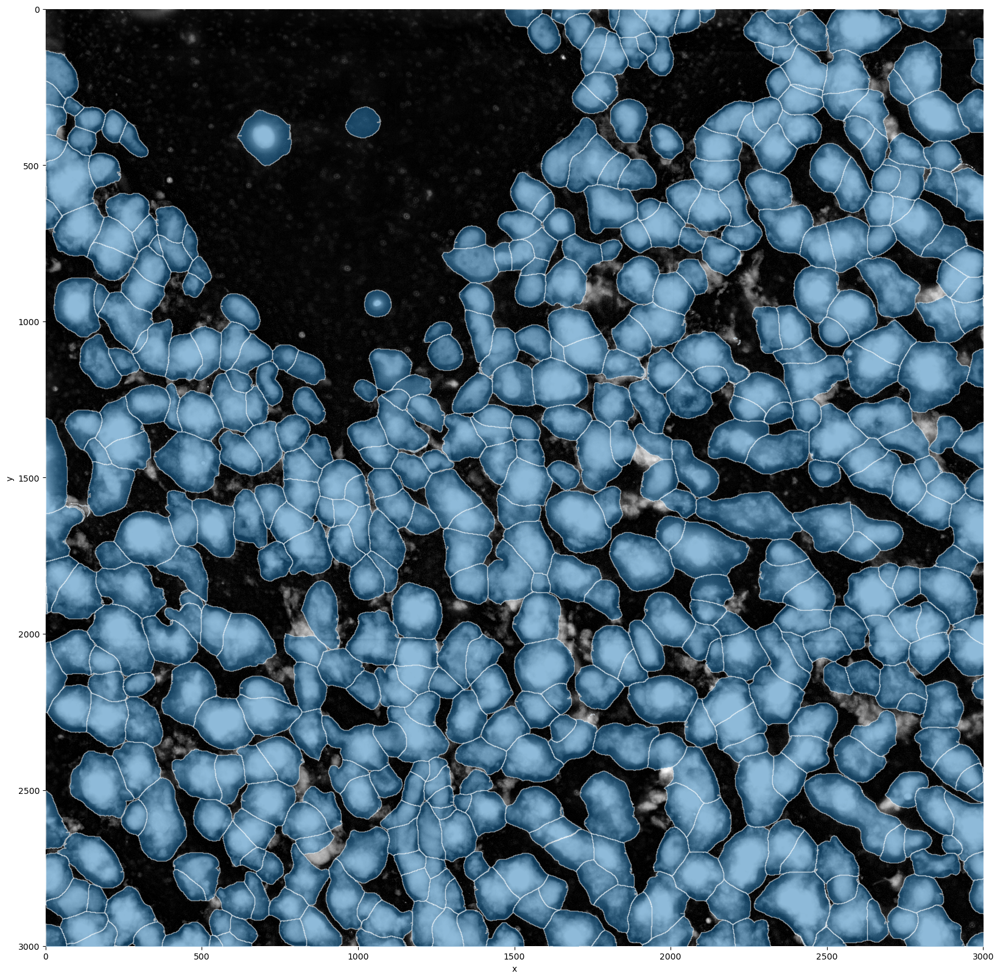

In [45]:
fc.plot_shapes(adata,library_id='spatial_transcriptomics')

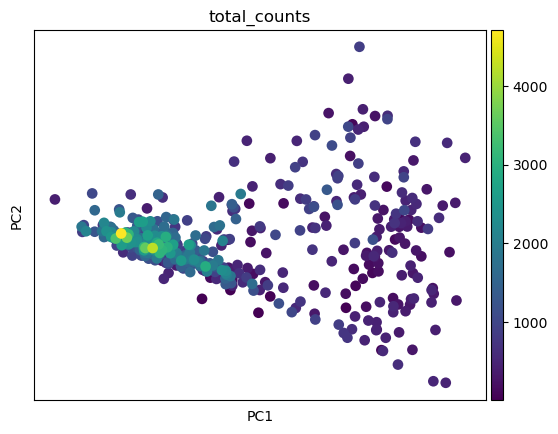

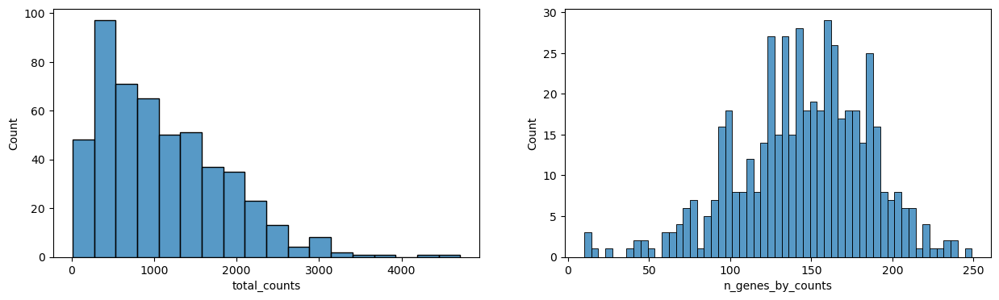

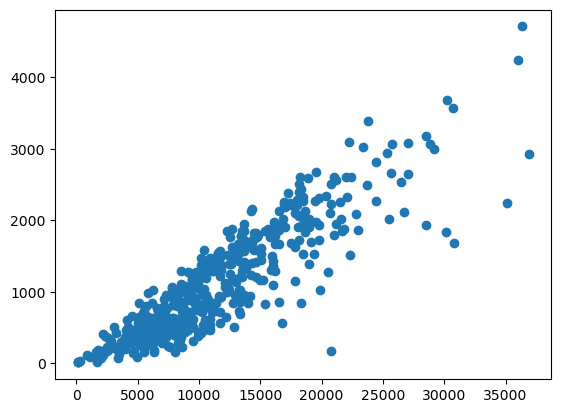

In [46]:
adata, adata_orig = fc.preprocessAdata(adata, masks)
fc.preprocesAdataPlot(adata, adata_orig)

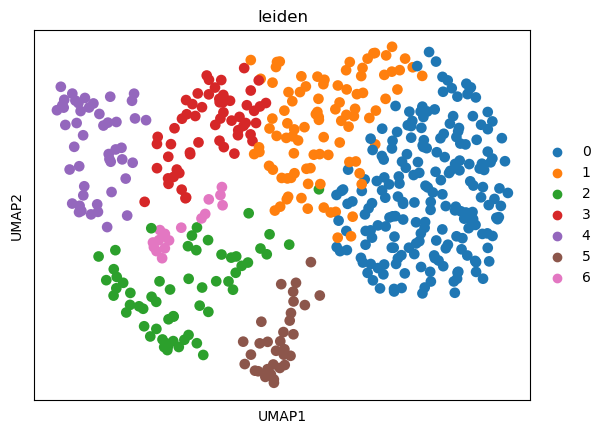

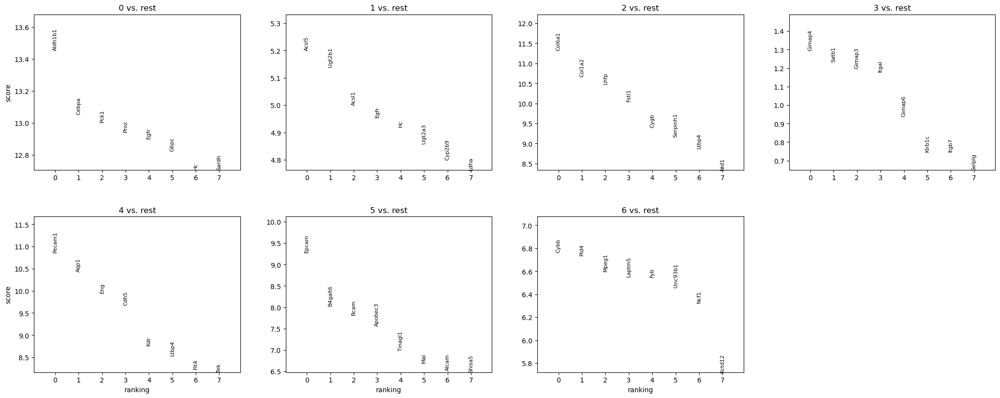

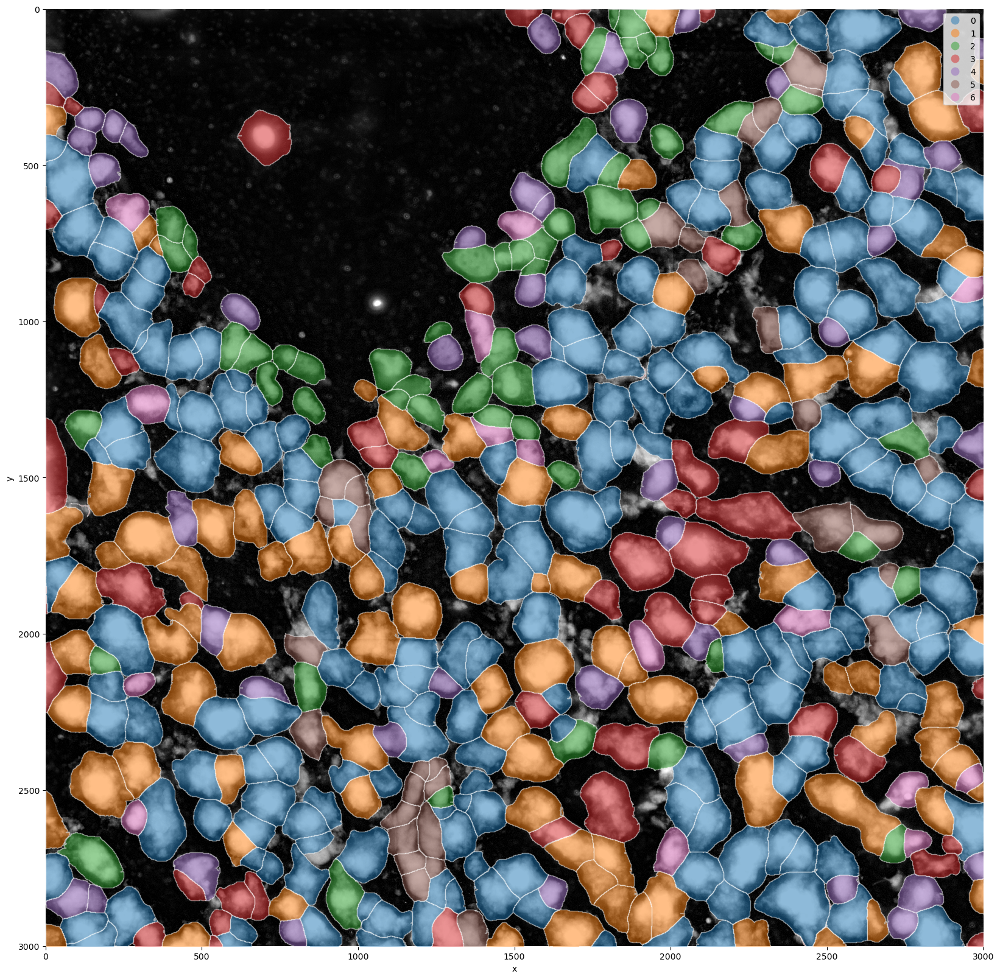

In [47]:
adata = fc.clustering(adata, 25, 30)
fc.clustering_plot(adata)
fc.plot_shapes(adata, column="leiden",library_id='spatial_transcriptomics')

/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and 

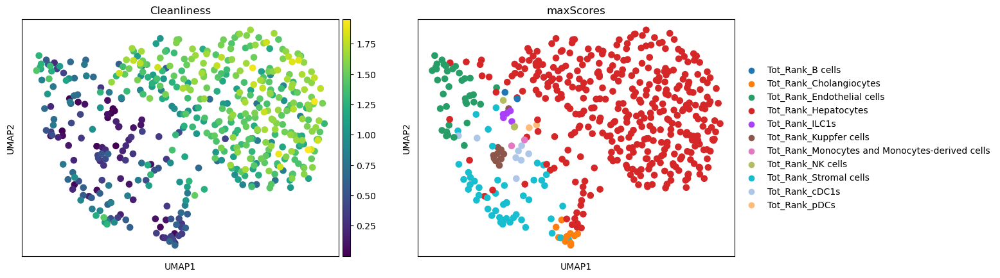

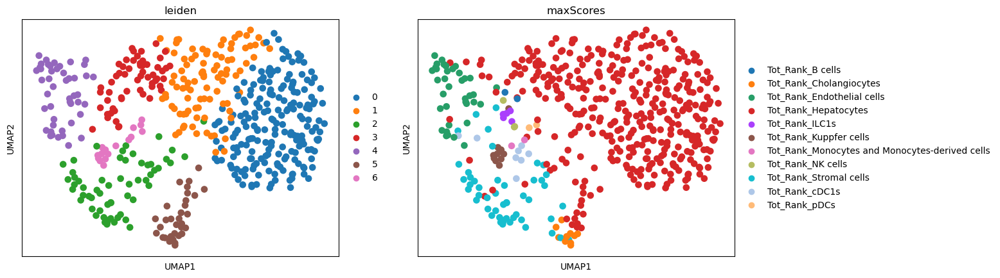

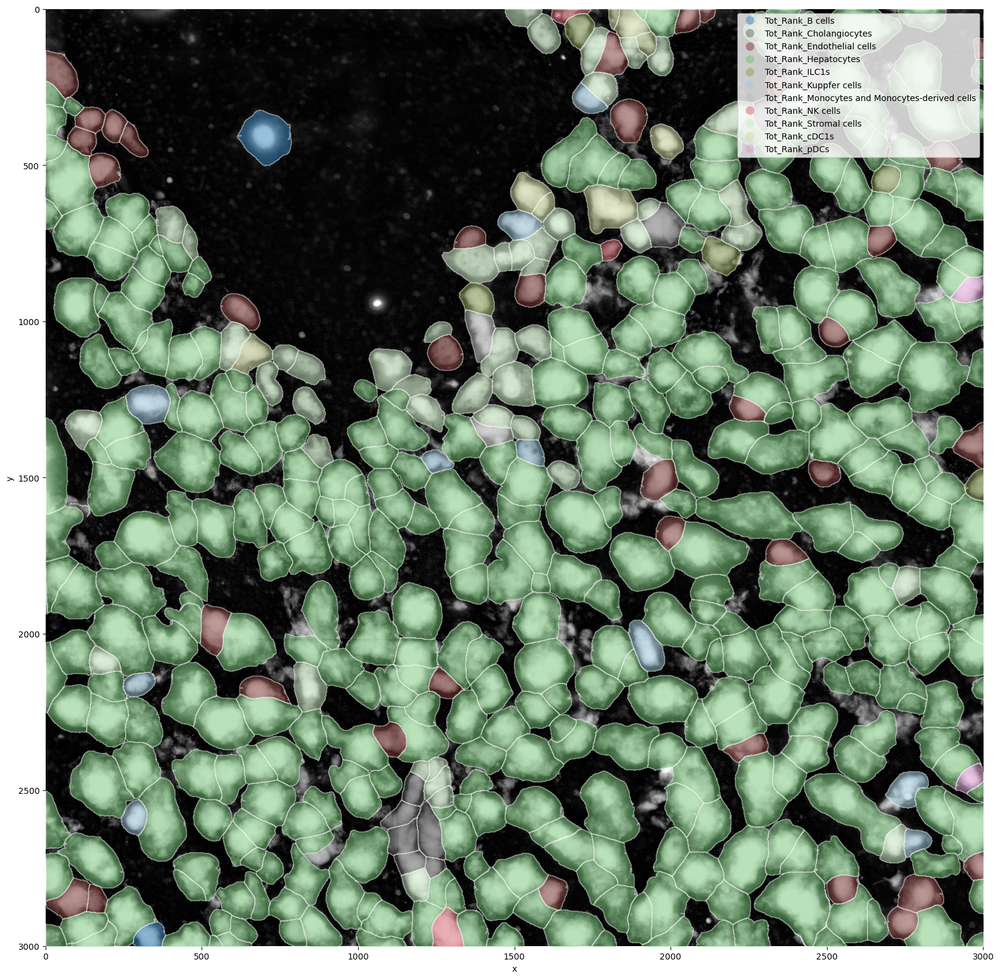

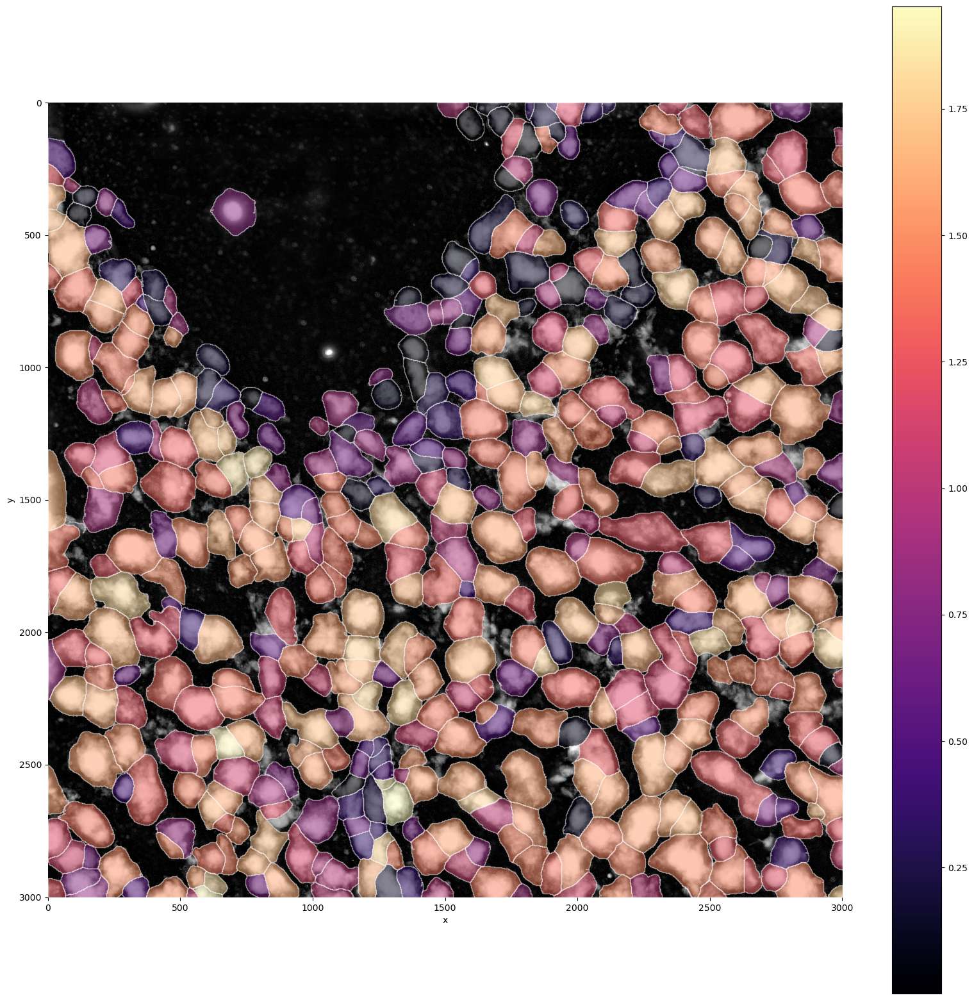

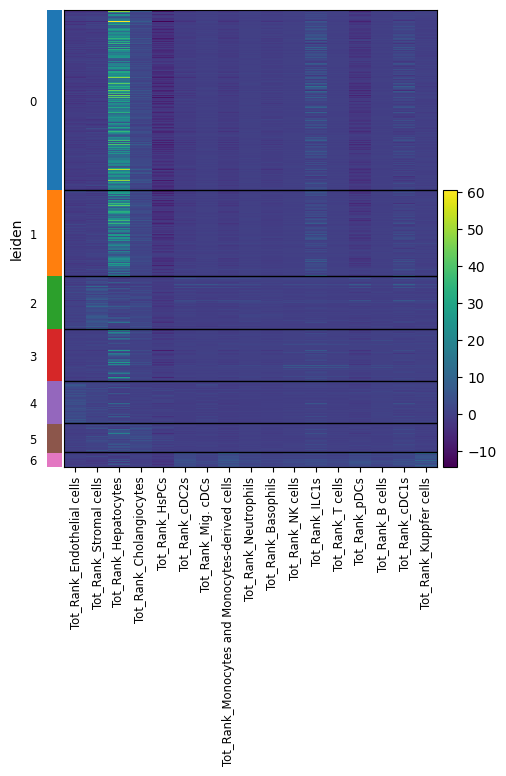

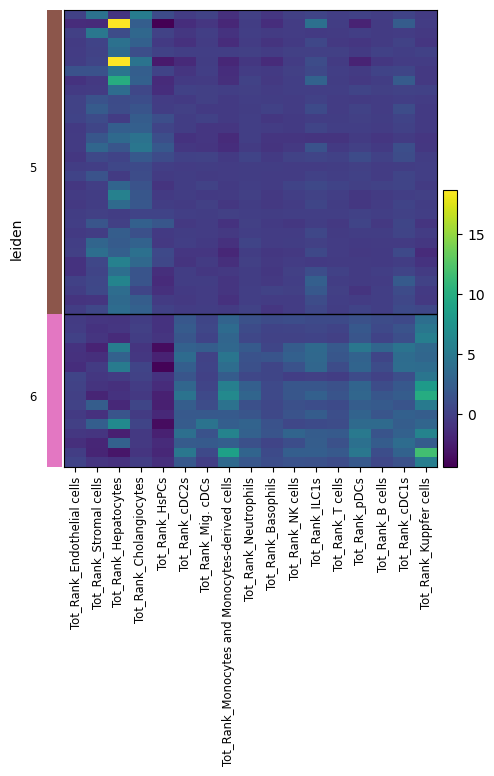

In [48]:
path_mg = "/srv/scratch/lottep/vizgen/markerGenesVizgen.csv"

mg_dict, scoresper_cluster = fc.scoreGenes(adata, path_mg, repl_columns={"Tot_Score_": ""})
fc.scoreGenesPlot(adata, scoresper_cluster, 5,library_id='spatial_transcriptomics')

In [49]:
colors = ['#914d22','#c61b84','#ec67a7','#edabcb','#5da6db','#8f4716','#fa8307','#b0763a','#d0110b','#f62c4f','#fed8b1','#cc7722','#929591','#E45466','#a31a2a']
adata_p, color_dict = fc.clustercleanliness(adata, list(mg_dict.keys()), colors=colors)


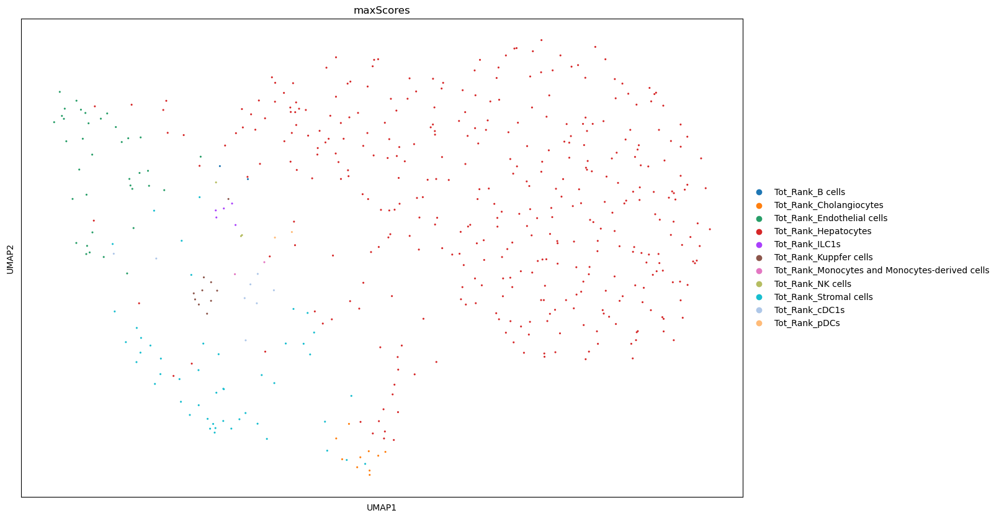

(1.8534265160560608, 13.988944709300995, 7.964165449142456, 15.264137506484985)

In [50]:
 _, ax = plt.subplots(1, 1, figsize=(15, 10))
sc.pl.umap(adata, color=["maxScores"], ax=ax,size=20)
ax.axis("off")

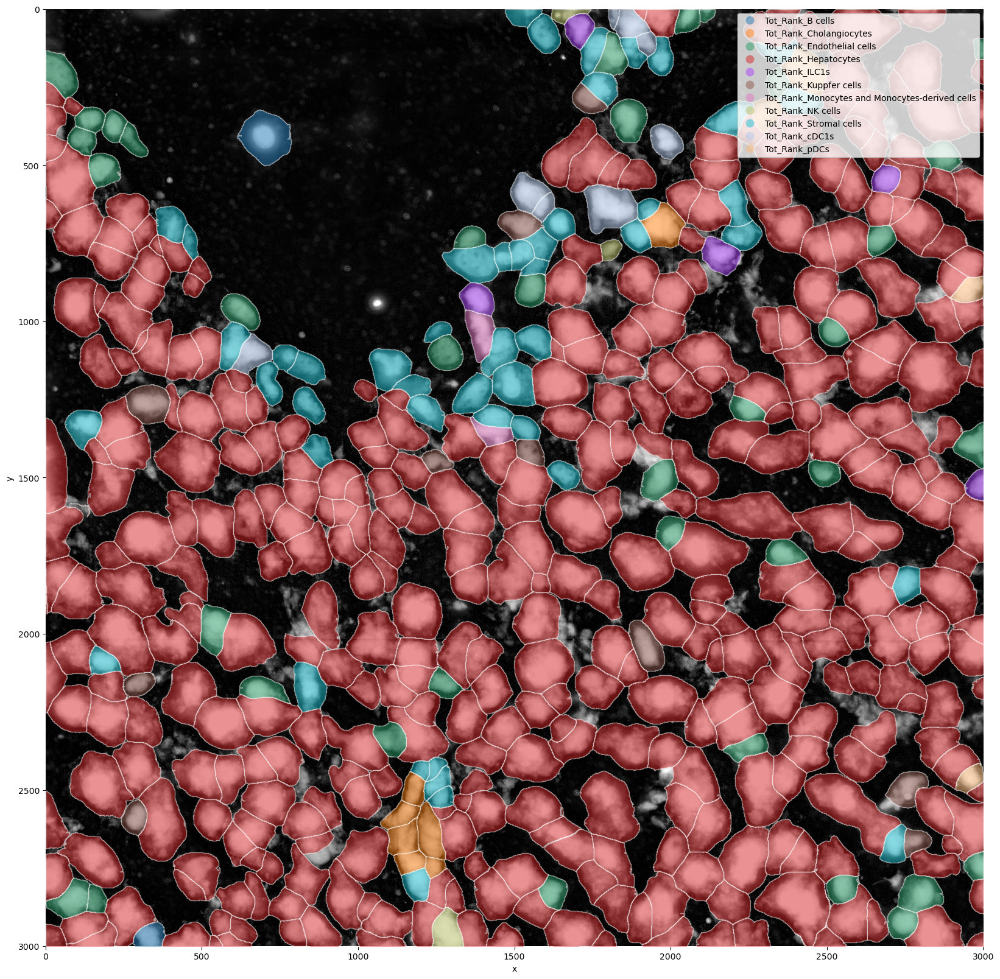

In [25]:
fc.plot_shapes(adata,column='maxScores',library_id='spatial_transcriptomics')

In [31]:
name_slide='temp_test'
fc.save_data(adata, "/srv/scratch/lottep/vizgen/" + name_slide + ".geojson", "/srv/scratch/lottep/vizgen/" + name_slide + ".h5ad")